# Setup

In [1]:
# Import libraries
%matplotlib inline
import sys
import os
from dotenv import load_dotenv
import numpy as np
from PIL import Image

load_dotenv()
sys.path.append(os.getenv('CODE_ROOT_PATH')) # Add path

from src.visualization.visualization_utility import generate_image, create_paths

NN_PATH = os.getenv('NN_PATH')
PREPROCESSED_DATA_DIR = os.getenv('PREPROCESSED_DATA_DIR')
TRAINED_MODELS = os.getenv('TRAINED_MODELS')

# Display All ANN Queries

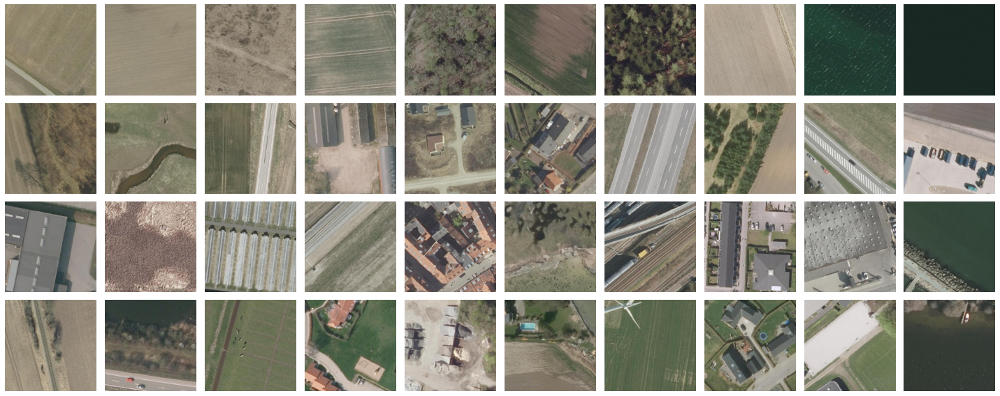

In [2]:
example_indices = np.load(os.path.join(os.getenv('TRAINED_MODELS'), 'nn_query_indices.npy'))
example_paths = [os.path.join(PREPROCESSED_DATA_DIR, str(example_indices[i])+'.npy') for i in range(len(example_indices))]
generate_image(example_paths, num_rows=4, num_cols=10, out_file=os.path.join(os.getenv('FIGURES_DIR'), 'nearest_neighbors', 'example_patches.png'))

# Nearest Neighbors
- `MODEL`: `"tiny"`, `"tiny_longer"`, `"small"`, `"small_pretrained"`
- `NN_ARRAY`: `"easy"`, `"medium"`, `"hard"`
- `PATCH_INDEX` < `10` (`"easy"`), `20` (`"medium"`), `10` (`"hard"`)

In [3]:
MODEL = 'tiny'  # tiny, tiny_longer, small, small_pretrained
CATEGORY = 'medium'
PATCH_INDEX = 5
if CATEGORY == 'easy': NUM_NN = 100
if CATEGORY == 'medium': NUM_NN = 50
if CATEGORY == 'hard': NUM_NN = 20

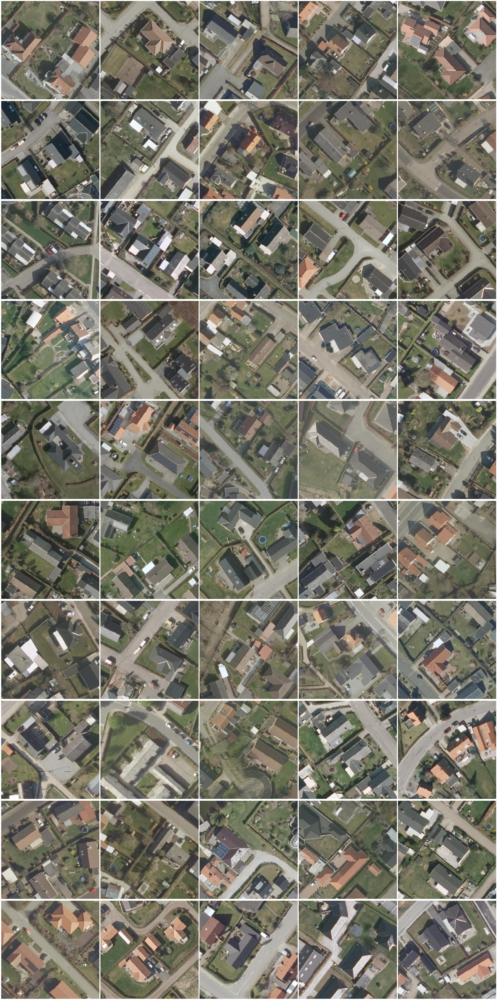

In [4]:
paths = create_paths(TRAINED_MODELS, MODEL, CATEGORY, PATCH_INDEX)[1:]  # Omit the first path, as it is the query itself
generate_image(paths, num_rows=int(NUM_NN/5), num_cols=5, fig_size_factor=40)